In [4]:
from pydub import AudioSegment
from pydub.silence import split_on_silence

# Variables for the audio file
# You need to download this file from here: https://etc.usf.edu/lit2go/1/alices-adventures-in-wonderland/1/chapter-i-down-the-rabbit-hole/
file_path = "trial_audio/trial_2.mp3"
file_name = file_path.split('/')[-1]
audio_format = "mp3"

# Reading and splitting the audio file into chunks
sound = AudioSegment.from_file(file_path, format = audio_format) 
audio_chunks = split_on_silence(sound
                            ,min_silence_len = 100
                            ,silence_thresh = -45
                            ,keep_silence = 50
                        )

# Putting the file back together
combined = AudioSegment.empty()
for chunk in audio_chunks:
    combined += chunk
combined.export(f'trial_audio/result3.mp3', format = audio_format)

<_io.BufferedRandom name='trial_audio/result3.mp3'>

In [12]:
from __future__ import print_function
import numpy as np
import matplotlib.pyplot as plt
import librosa
import soundfile as sf

import librosa.display

In [37]:
y, sr = librosa.load('trial_audio/trial5.mp3')


# And compute the spectrogram magnitude and phase
S_full, phase = librosa.magphase(librosa.stft(y))

In [40]:
idx = slice(*librosa.time_to_frames([30, 35], sr=sr))
# plt.figure(figsize=(12, 4))
# librosa.display.specshow(librosa.amplitude_to_db(S_full[:, idx], ref=np.max),
#                          y_axis='log', x_axis='time', sr=sr)
# plt.colorbar()
# plt.tight_layout()

In [41]:
# We'll compare frames using cosine similarity, and aggregate similar frames
# by taking their (per-frequency) median value.
#
# To avoid being biased by local continuity, we constrain similar frames to be
# separated by at least 2 seconds.
#
# This suppresses sparse/non-repetetitive deviations from the average spectrum,
# and works well to discard vocal elements.

S_filter = librosa.decompose.nn_filter(S_full,
                                       aggregate=np.median,
                                       metric='cosine',
                                       width=int(librosa.time_to_frames(2, sr=sr)))

# The output of the filter shouldn't be greater than the input
# if we assume signals are additive.  Taking the pointwise minimium
# with the input spectrum forces this.
S_filter = np.minimum(S_full, S_filter)

In [42]:
# We can also use a margin to reduce bleed between the vocals and instrumentation masks.
# Note: the margins need not be equal for foreground and background separation
margin_i, margin_v = 2, 10
power = 2

mask_i = librosa.util.softmask(S_filter,
                               margin_i * (S_full - S_filter),
                               power=power)

mask_v = librosa.util.softmask(S_full - S_filter,
                               margin_v * S_filter,
                               power=power)

# Once we have the masks, simply multiply them with the input spectrum
# to separate the components

S_foreground = mask_v * S_full
S_background = mask_i * S_full

ValueError: zero-size array to reduction operation maximum which has no identity

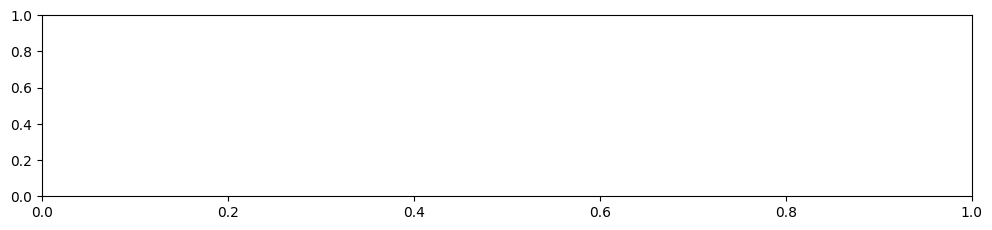

In [43]:
# sphinx_gallery_thumbnail_number = 2

plt.figure(figsize=(12, 8))
plt.subplot(3, 1, 1)
librosa.display.specshow(librosa.amplitude_to_db(S_full[:, idx], ref=np.max),
                         y_axis='log', sr=sr)
plt.title('Full spectrum')
plt.colorbar()

plt.subplot(3, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(S_background[:, idx], ref=np.max),
                         y_axis='log', sr=sr)
plt.title('Background')
plt.colorbar()
plt.subplot(3, 1, 3)
librosa.display.specshow(librosa.amplitude_to_db(S_foreground[:, idx], ref=np.max),
                         y_axis='log', x_axis='time', sr=sr)
plt.title('Foreground')
plt.colorbar()
plt.tight_layout()
plt.show()

In [34]:
#librosa.amplitude_to_db(S_foreground[:, idx], ref=np.max)
D_foreground = S_foreground * phase
y_foreground = librosa.istft(D_foreground)
D_background = S_background * phase
y_background = librosa.istft(D_background)
sf.write('trial_audio/result10.mp3', y_foreground, sr)

In [16]:
from pydub import AudioSegment
from pydub.playback import play

song = AudioSegment.from_wav("trial_audio/result4.wav")
play(song)

ValueError: Number of channels must be 1 or 2.

In [2]:
from youtube import youtube_handler
from ASR_Model import asr_handler
keyword = "العربية"
videos = youtube_handler.Youtube(keyword,"ar","EG",9)
videos.download("youtube/downloads")
asr = asr_handler.AsrHandler(keyword,"YouTube")
asr.preprocess()
asr.trim()
youtube_asr_result = asr.transcribe()
print(youtube_asr_result)

_rewJPptlBg is streaming live and cannot be loaded
bNyUyrR0PHo is streaming live and cannot be loaded
jp8E8B6_lIc is streaming live and cannot be loaded
ffmpeg -i youtube/downloads/9af50f04-15a9-4285-9d52-796cd567218f/27fc9cf9-4fea-404c-8a72-78df37c9023e.wav -ac 1 -ar 22050 ASR_Model/processed_audio_files/YouTube/9af50f04-15a9-4285-9d52-796cd567218f/27fc9cf9-4fea-404c-8a72-78df37c9023e.wav
ffmpeg -i youtube/downloads/9af50f04-15a9-4285-9d52-796cd567218f/2f85c0ef-611b-435e-b744-363dc0227fbb.wav -ac 1 -ar 22050 ASR_Model/processed_audio_files/YouTube/9af50f04-15a9-4285-9d52-796cd567218f/2f85c0ef-611b-435e-b744-363dc0227fbb.wav
ffmpeg -i youtube/downloads/9af50f04-15a9-4285-9d52-796cd567218f/31125e48-64c8-48d1-a078-5d22c2f5aa69.wav -ac 1 -ar 22050 ASR_Model/processed_audio_files/YouTube/9af50f04-15a9-4285-9d52-796cd567218f/31125e48-64c8-48d1-a078-5d22c2f5aa69.wav
ffmpeg -i youtube/downloads/9af50f04-15a9-4285-9d52-796cd567218f/348a7f7b-d081-4aad-845e-ec462c8167e7.wav -ac 1 -ar 22050 ASR_M

In [3]:
print(len(youtube_asr_result))

7


In [5]:
import librosa
from IPython.display import Audio

# Load audio file
audio_file, sr = librosa.load('trial_audio/trial3.wav')

# Separate harmonic and percussive components
harmonic, percussive = librosa.effects.hpss(audio_file)

Audio(data=audio_file, rate=sr)

In [7]:
Audio(data=percussive, rate=sr)

In [9]:
from __future__ import unicode_literals
import youtube_dl

# Set up options for the youtube_dl downloader
ydl_opts = {
    'format': 'best',
    'ignoreerrors': True,
    'playlistend': 10  # Set to the number of videos to download (optional)
}

# Set the channel URL
channel_url = "https://www.youtube.com/@JustYusuf10"

# Use the youtube_dl downloader to download the videos
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    print("downloading...")
    ydl.download([channel_url])

downloading...
[youtube:tab] @JustYusuf10: Downloading webpage
[download] Downloading playlist: JustYusuf - Home
[youtube:tab] playlist JustYusuf - Home: Downloading 2 videos
[download] Downloading video 1 of 2
[youtube:tab] @JustYusuf10: Downloading webpage
[download] Downloading playlist: JustYusuf - Videos
[youtube:tab] playlist JustYusuf - Videos: Downloading 10 videos
[download] Downloading video 1 of 10
[youtube] v5WQ_UJMAiI: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 2 of 10
[youtube] MuSjMy8iN3Q: Downloading webpage
[youtube] MuSjMy8iN3Q: Downloading player 11e3a4ec


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 3 of 10
[youtube] ySUQ0SLQbAE: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 4 of 10
[youtube] gjPI1G0JxbE: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 5 of 10
[youtube] 1moZWKFauro: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 6 of 10
[youtube] A9ycjgND3nQ: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 7 of 10
[youtube] TPpw8N4njBQ: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 8 of 10
[youtube] 5jJzfs0Xjig: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 9 of 10
[youtube] Sjat_zW0HOY: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 10 of 10
[youtube] -bkQnHG5XrQ: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Finished downloading playlist: JustYusuf - Videos
[download] Downloading video 2 of 2
[youtube:tab] @JustYusuf10: Downloading webpage
[download] Downloading playlist: JustYusuf - Videos
[youtube:tab] playlist JustYusuf - Videos: Downloading 10 videos
[download] Downloading video 1 of 10
[youtube] v5WQ_UJMAiI: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 2 of 10
[youtube] MuSjMy8iN3Q: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 3 of 10
[youtube] ySUQ0SLQbAE: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 4 of 10
[youtube] gjPI1G0JxbE: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 5 of 10
[youtube] 1moZWKFauro: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 6 of 10
[youtube] A9ycjgND3nQ: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 7 of 10
[youtube] TPpw8N4njBQ: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 8 of 10
[youtube] 5jJzfs0Xjig: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 9 of 10
[youtube] Sjat_zW0HOY: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Downloading video 10 of 10
[youtube] -bkQnHG5XrQ: Downloading webpage


ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.


[download] Finished downloading playlist: JustYusuf - Videos
[download] Finished downloading playlist: JustYusuf - Home


In [19]:
import youtube_dl

# Set the channel URL
channel_url = "https://www.youtube.com/@JustYusuf10"

# Set the download options
download_options = {
    'format': 'worst',
    'outtmpl': '%(title)s.%(ext)s',
    'ignoreerrors': True,
    'no_warnings': True,
    'playlist_items': None,
    'quiet': False,
}

# Create the YouTubeDL object and download the videos
with youtube_dl.YoutubeDL(download_options) as ydl:
    ydl.extract_info("UC_x5XG1OV2P6uZZ5FSM9Ttw", download=True)

ERROR: 'UC_x5XG1OV2P6uZZ5FSM9Ttw' is not a valid URL. Set --default-search "ytsearch" (or run  youtube-dl "ytsearch:UC_x5XG1OV2P6uZZ5FSM9Ttw" ) to search YouTube


In [32]:
from youtubesearchpython import ChannelSearch

# Search for channels with the keyword 'justin bieber'
result = ChannelSearch('Sidemen').result()
print(result)

TypeError: ChannelSearch.__init__() missing 1 required positional argument: 'browseId'

In [31]:
import youtube_dl

# Set the channel ID
channel_id = "UCDogdKl7t7NHzQ95aEwkdMw"

# Set the download options
download_options = {
    'ignoreerrors': True,
    'no_warnings': True,
    'extract_flat': True,
    'channel_id': channel_id,
}

# Create the YouTubeDL object and get the video information
with youtube_dl.YoutubeDL(download_options) as ydl:
    video_info = ydl.extract_info(f"https://www.youtube.com/@Sidemen", download=False)

print(video_info)

# Get the list of video URLs
video_urls = []
for entry in video_info['entries']:
    if entry:
        video_urls.append(f"https://www.youtube.com/watch?v={entry['id']}")

# Print the list of video URLs
print(video_urls)

[youtube:tab] @Sidemen: Downloading webpage
[download] Downloading playlist: Sidemen - Home
[youtube:tab] playlist Sidemen - Home: Downloading 3 videos
[download] Downloading video 1 of 3
[download] Downloading video 2 of 3
[download] Downloading video 3 of 3
[download] Finished downloading playlist: Sidemen - Home
{'_type': 'playlist', 'entries': [{'_type': 'url', 'url': 'https://www.youtube.com/@Sidemen/videos?view=0&sort=dd&shelf_id=0', 'ie_key': None, 'title': 'Videos'}, {'_type': 'url', 'url': 'https://www.youtube.com/@Sidemen/videos?view=0&sort=p&shelf_id=0', 'ie_key': None, 'title': 'Popular videos'}, {'_type': 'url', 'url': 'https://www.youtube.com/playlist?list=PLjkZIuJPz3rPW7CiiVlXoCQ5Ua1BXbUJJ', 'ie_key': None, 'title': 'The Sidemen Show : Season 1'}], 'id': 'UCDogdKl7t7NHzQ95aEwkdMw', 'title': 'Sidemen - Home', 'description': 'Welcome to the official Sidemen channel. The home of #SidemenSundays - We post new Sidemen videos every single Sunday!', 'extractor': 'youtube:tab', 

KeyError: 'id'

In [39]:
import youtube_dl

# Set the channel URL
channel_url = "https://www.youtube.com/channel/UCDogdKl7t7NHzQ95aEwkdMw"

# Set the options for youtube-dl
ydl_opts = {
    'ignoreerrors': True,
    'quiet': True,
    'extract_flat': True,
    'skip_download': True,
    'no_warnings': True,
    'simulate': True,
    'dump_single_json': True,
    'playlist_items': '1-1000',
    'extractor_args': ['--youtube-skip-dash-manifest'],
}

# Create the youtube-dl object and retrieve the video URLs
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    data = ydl.extract_info(channel_url, download=False)
    print(data)
    # video_urls = [f"https://www.youtube.com/watch?v={video['id']}" for video in data['entries']]

# Print the list of video URLs
# print(video_urls)


{'_type': 'playlist', 'entries': [{'_type': 'url', 'url': 'https://www.youtube.com/@Sidemen/videos?view=0&sort=dd&shelf_id=0', 'ie_key': None, 'title': 'Videos'}, {'_type': 'url', 'url': 'https://www.youtube.com/@Sidemen/videos?view=0&sort=p&shelf_id=0', 'ie_key': None, 'title': 'Popular videos'}, {'_type': 'url', 'url': 'https://www.youtube.com/playlist?list=PLjkZIuJPz3rPW7CiiVlXoCQ5Ua1BXbUJJ', 'ie_key': None, 'title': 'The Sidemen Show : Season 1'}], 'id': 'UCDogdKl7t7NHzQ95aEwkdMw', 'title': 'Sidemen - Home', 'description': 'Welcome to the official Sidemen channel. The home of #SidemenSundays - We post new Sidemen videos every single Sunday!', 'extractor': 'youtube:tab', 'webpage_url': 'https://www.youtube.com/channel/UCDogdKl7t7NHzQ95aEwkdMw', 'webpage_url_basename': 'UCDogdKl7t7NHzQ95aEwkdMw', 'extractor_key': 'YoutubeTab'}


In [65]:
import youtube_dl
playlist_url = "https://www.youtube.com/@Sidemen/videos"

# Set the options for youtube-dl
ydl_opts = {
    'ignoreerrors': True,
    'quiet': True,
    'extract_flat': True,
    'skip_download': True,
    'format':"%(upload_date)s",
    'no_warnings': True,
    'simulate': True,
    'dump_single_json': True,
    'playlistend': 10,
    'extractor_args': ['--youtube-skip-dash-manifest'],
}

# Create the youtube-dl object and retrieve the video URLs
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    data = ydl.extract_info(playlist_url, download=False)
    video_urls = [{"Link": f"https://www.youtube.com/watch?v={video['id']}", "title":video['title'], "ID":video["id"]} for video in data['entries']]
    
# Print the list of video URLs
# print(video_urls)


In [66]:
print(len(video_urls))

10


In [2]:
from modules.youtube_module import youtube_handler

youtube = youtube_handler.Youtube("@eXtranews")
youtube.download("modules/youtube_module/downloads")

'NoneType' object has no attribute 'download'


In [3]:
import os, shutil
def remove_files_from_dir(folder):
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        try:
            if os.path.isfile(file_path) or os.path.islink(file_path):
                os.unlink(file_path)
            elif os.path.isdir(file_path):
                shutil.rmtree(file_path)
        except Exception as e:
            print('Failed to delete %s. Reason: %s' % (file_path, e))